### We begin with boilerplate:

In [1]:
%matplotlib inline 
import matplotlib.pyplot as plt
from IPython.display import HTML
plt.rcParams["figure.figsize"] = [12, 5]

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import numpy as np

In [4]:
import logging
logging.basicConfig(format='%(asctime)s %(levelname)s:%(message)s', level=logging.INFO)

# Covid epidemic simulator

In [5]:
from codit.disease import Covid
from codit.outbreak import Outbreak
from codit.population.covid import PersonCovid
import codit.society as society
import codit.config

from codit.population.networks.city import CityPopulation
from codit.population.networks.city_config.city_cfg import POPULATION_CITY

### Baseline config of the simulation

In [6]:
codit.config.print_baseline_config()

DAILY_TEST_CAPACITY_PER_HEAD 0.0075
DAYS_BEFORE_INFECTIOUS 4
DAYS_INFECTIOUS_TO_SYMPTOMS 2
DAYS_OF_SYMPTOMS 5
DURATION_OF_ISOLATION 10
MEAN_NETWORK_SIZE 9.0
PROB_APPLY_FOR_TEST_IF_SYMPTOMS 0.75
PROB_GET_TEST_IF_TRACED 0.75
PROB_INFECT_IF_TOGETHER_ON_A_DAY 0.025
PROB_ISOLATE_IF_SYMPTOMS 0.75
PROB_ISOLATE_IF_TESTPOS 0.3
PROB_ISOLATE_IF_TRACED 0.3
PROB_NON_C19_SYMPTOMS_PER_DAY 0.01
PROB_SYMPTOMATIC 0.6
PROB_TEST_IF_REQUESTED 1
PROB_TRACING_GIVEN_CONTACT 0.6000000000000001
SIMULATOR_PERIODS_PER_DAY 1
TEST_DAYS_ELAPSED 1
_PROPORTION_OF_INFECTED_WHO_GET_TESTED 0.44999999999999996
_TARGET_R0 1.4


We are going to work with a small town of a few thousand people.

In [7]:
pop = CityPopulation(POPULATION_CITY, society.Society(), person_type=PersonCovid)

2021-02-02 14:02:34,399 INFO:Building a set of 317255 households from which to build a population
2021-02-02 14:02:38,887 INFO:There are 317255 households generated for accommodation buildings
2021-02-02 14:14:11,740 INFO:311452 households of mean size 2.55
2021-02-02 14:14:12,420 INFO:Only putting children >12 years old into classrooms.
2021-02-02 14:14:12,608 INFO:1915 classrooms of mean size 30.92
2021-02-02 14:14:12,879 INFO:123 care_homes of mean size 103.50
2021-02-02 14:14:13,729 INFO:93340 workplaces of mean size 5.61
2021-02-02 14:14:13,785 INFO:Adding 406830 permanent contact groups
2021-02-02 14:14:13,909 INFO:Adding 39657 ephemeral contact pairs


Randomly, we put them into fixed and overlapping social groupings, where each person has a small network.

In [8]:
nets = [len(p.contacts) for p in pop.people]

In [9]:
np.mean(nets)

12.942399755906594

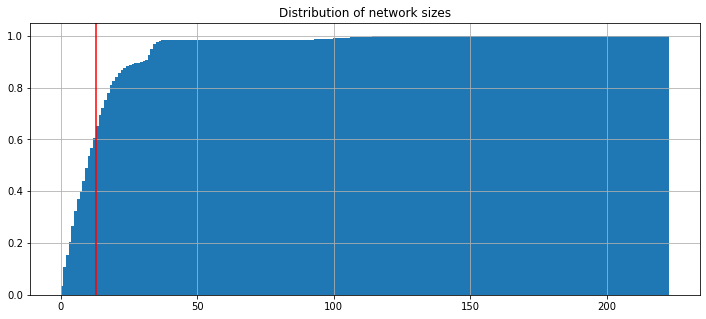

In [10]:
plt.hist(nets, cumulative=True, density=True, bins=2000)
plt.title('Distribution of network sizes')
plt.axvline(np.mean(nets), color='r')
plt.grid()

### Finally ready to simulate:

We will place the population that we have created, into various settings and societies in the upcoming simulations

In [11]:
SHOW_HEATMAP = True
IS_HTML5 = False
POP_SIZE = POPULATION_CITY
PREVALENCE = 1/560 * 4
SCALE_SETTINGS = dict(n_days = 201, pop_size = POP_SIZE, seed_size = int(POP_SIZE*PREVALENCE), population=pop, show_heatmap = SHOW_HEATMAP)
SCALE_SETTINGS

{'n_days': 201,
 'pop_size': 793139,
 'seed_size': 5665,
 'population': <codit.population.networks.city.CityPopulation at 0x7fef944fbe80>,
 'show_heatmap': True}

Our baseline simulation is of a runaway infection.

In [12]:
f"We start with {int(POP_SIZE*PREVALENCE)} people infected in a population of {POP_SIZE}."

'We start with 5665 people infected in a population of 793139.'

We begin by studying a society where people don't know whether or how to self-isolate:

In [13]:
s_basic = society.Society(config=dict(PROB_ISOLATE_IF_SYMPTOMS = 0))
o_basic = Outbreak(s_basic, Covid(), **SCALE_SETTINGS).simulate()

2021-02-02 14:14:31,208 WARNING:Using a pre-existing population - does it have the right network structure?
2021-02-02 14:14:46,766 INFO:Day 1, prop infected is 0.01, prop infectious is 0.0051
2021-02-02 14:14:58,299 INFO:Day 8, prop infected is 0.03, prop infectious is 0.0106
2021-02-02 14:15:11,605 INFO:Day 15, prop infected is 0.06, prop infectious is 0.0266
2021-02-02 14:15:24,412 INFO:Day 22, prop infected is 0.11, prop infectious is 0.0363
2021-02-02 14:15:37,493 INFO:Day 29, prop infected is 0.17, prop infectious is 0.0520
2021-02-02 14:15:51,115 INFO:Day 36, prop infected is 0.25, prop infectious is 0.0714
2021-02-02 14:16:05,148 INFO:Day 43, prop infected is 0.33, prop infectious is 0.0845
2021-02-02 14:16:19,326 INFO:Day 50, prop infected is 0.41, prop infectious is 0.0817
2021-02-02 14:16:32,880 INFO:Day 57, prop infected is 0.47, prop infectious is 0.0673
2021-02-02 14:16:45,701 INFO:Day 64, prop infected is 0.50, prop infectious is 0.0483
2021-02-02 14:16:58,006 INFO:Day 7

2021-02-02 14:20:23,042 INFO: Realized R0 of early infections is 1.48
2021-02-02 14:20:23,043 INFO: 56.1 percent of the proportion was infected during the epidemic


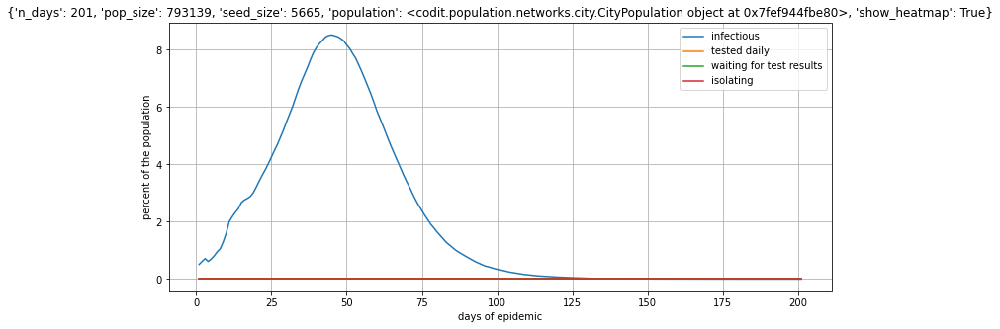

In [14]:
o_basic.plot(title=str(SCALE_SETTINGS))

Lets put that on a log scale:

2021-02-02 14:20:23,321 INFO: Realized R0 of early infections is 1.48
2021-02-02 14:20:23,322 INFO: 56.1 percent of the proportion was infected during the epidemic


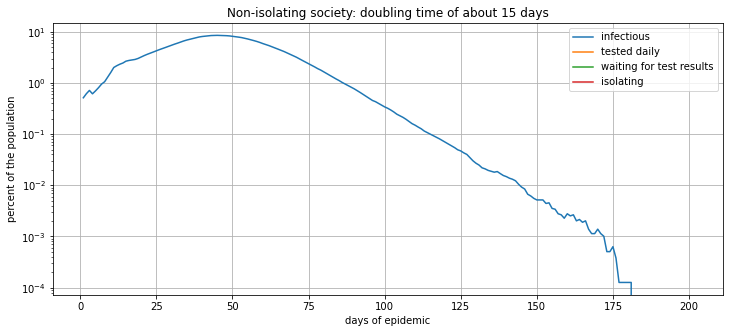

In [15]:
o_basic.plot(logy=True, title='Non-isolating society: doubling time of about 15 days')

In [16]:
HTML(o_basic.outbreak_visualise(IS_HTML5))

2021-02-02 14:20:23,991 INFO:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


Next, suppose that people know to isolate if they show symptoms, and 75% do so - this is similar to what is going on in the UK now:

In [17]:
s_isolate = society.Society(config=dict(PROB_ISOLATE_IF_SYMPTOMS = 0.75))
o_isolate = Outbreak(s_isolate, Covid(), **SCALE_SETTINGS).simulate()

2021-02-02 14:20:30,124 WARNING:Using a pre-existing population - does it have the right network structure?
2021-02-02 14:20:47,317 INFO:Day 1, prop infected is 0.01, prop infectious is 0.0051
2021-02-02 14:20:59,968 INFO:Day 8, prop infected is 0.02, prop infectious is 0.0076
2021-02-02 14:21:13,553 INFO:Day 15, prop infected is 0.04, prop infectious is 0.0154
2021-02-02 14:21:26,858 INFO:Day 22, prop infected is 0.05, prop infectious is 0.0132
2021-02-02 14:21:39,214 INFO:Day 29, prop infected is 0.07, prop infectious is 0.0150
2021-02-02 14:21:51,603 INFO:Day 36, prop infected is 0.08, prop infectious is 0.0166
2021-02-02 14:22:03,998 INFO:Day 43, prop infected is 0.10, prop infectious is 0.0185
2021-02-02 14:22:16,761 INFO:Day 50, prop infected is 0.12, prop infectious is 0.0197
2021-02-02 14:22:29,784 INFO:Day 57, prop infected is 0.14, prop infectious is 0.0207
2021-02-02 14:22:42,440 INFO:Day 64, prop infected is 0.16, prop infectious is 0.0203
2021-02-02 14:22:55,084 INFO:Day 7

2021-02-02 14:26:44,975 INFO: Realized R0 of early infections is 1.15
2021-02-02 14:26:44,976 INFO: 27.4 percent of the proportion was infected during the epidemic


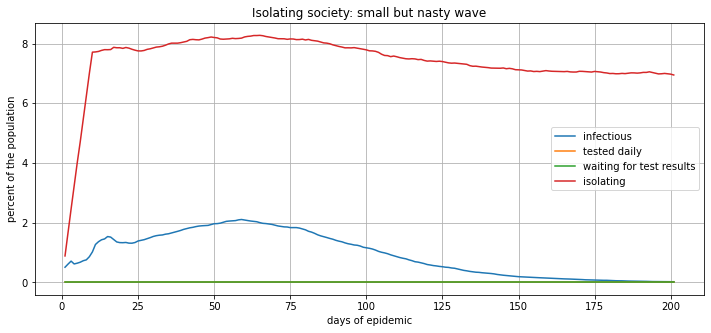

In [18]:
o_isolate.plot(title='Isolating society: small but nasty wave')

In [19]:
HTML(o_isolate.outbreak_visualise(IS_HTML5))

2021-02-02 14:26:45,194 INFO:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


So, now we can add testing:
 * initially, here, lets suppose that positive test results are just ignored, while -ve results let people out of isolation:

In [20]:
s_testignored = society.TestingSociety(config=dict(PROB_ISOLATE_IF_TESTPOS=0))
o_testignored = Outbreak(s_testignored, Covid(), **SCALE_SETTINGS).simulate()

2021-02-02 14:26:52,282 WARNING:Using a pre-existing population - does it have the right network structure?
2021-02-02 14:27:09,456 INFO:Day 1, prop infected is 0.01, prop infectious is 0.0051
2021-02-02 14:27:24,147 INFO:Day 8, prop infected is 0.02, prop infectious is 0.0078
2021-02-02 14:27:39,205 INFO:Day 15, prop infected is 0.04, prop infectious is 0.0168
2021-02-02 14:27:53,960 INFO:Day 22, prop infected is 0.05, prop infectious is 0.0147
2021-02-02 14:28:08,778 INFO:Day 29, prop infected is 0.07, prop infectious is 0.0170
2021-02-02 14:28:24,070 INFO:Day 36, prop infected is 0.09, prop infectious is 0.0205
2021-02-02 14:28:38,989 INFO:Day 43, prop infected is 0.12, prop infectious is 0.0234
2021-02-02 14:28:53,978 INFO:Day 50, prop infected is 0.15, prop infectious is 0.0254
2021-02-02 14:29:09,084 INFO:Day 57, prop infected is 0.17, prop infectious is 0.0265
2021-02-02 14:29:24,347 INFO:Day 64, prop infected is 0.20, prop infectious is 0.0261
2021-02-02 14:29:42,243 INFO:Day 7

2021-02-02 14:33:55,648 INFO: Realized R0 of early infections is 1.18
2021-02-02 14:33:55,649 INFO: 31.4 percent of the proportion was infected during the epidemic


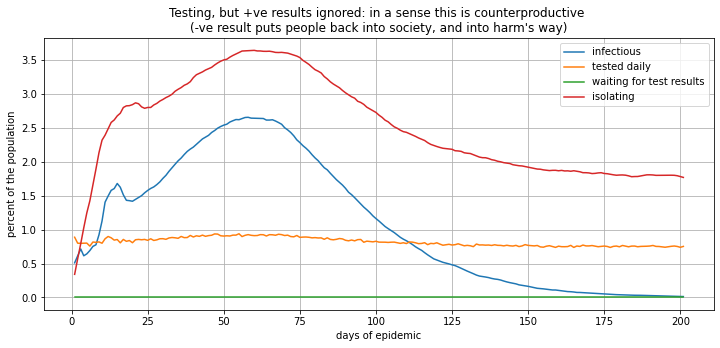

In [21]:
o_testignored.plot(title="Testing, but +ve results ignored: in a sense this is counterproductive \n"
                         "(-ve result puts people back into society, and into harm's way)")

In [22]:
HTML(o_testignored.outbreak_visualise(IS_HTML5))

2021-02-02 14:33:55,884 INFO:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


 * Now suppose that people respond to test results, some of the time:

In [23]:
o_test = Outbreak(society.TestingSociety(), Covid(), **SCALE_SETTINGS).simulate()

2021-02-02 14:34:03,125 WARNING:Using a pre-existing population - does it have the right network structure?
2021-02-02 14:34:19,117 INFO:Day 1, prop infected is 0.01, prop infectious is 0.0050
2021-02-02 14:34:33,714 INFO:Day 8, prop infected is 0.02, prop infectious is 0.0076
2021-02-02 14:34:48,845 INFO:Day 15, prop infected is 0.04, prop infectious is 0.0154
2021-02-02 14:35:07,319 INFO:Day 22, prop infected is 0.05, prop infectious is 0.0136
2021-02-02 14:35:22,594 INFO:Day 29, prop infected is 0.07, prop infectious is 0.0155
2021-02-02 14:35:37,201 INFO:Day 36, prop infected is 0.09, prop infectious is 0.0174
2021-02-02 14:35:51,961 INFO:Day 43, prop infected is 0.11, prop infectious is 0.0204
2021-02-02 14:36:06,827 INFO:Day 50, prop infected is 0.13, prop infectious is 0.0226
2021-02-02 14:36:21,961 INFO:Day 57, prop infected is 0.15, prop infectious is 0.0233
2021-02-02 14:36:36,856 INFO:Day 64, prop infected is 0.18, prop infectious is 0.0229
2021-02-02 14:36:51,430 INFO:Day 7

2021-02-02 14:41:08,596 INFO: Realized R0 of early infections is 1.16
2021-02-02 14:41:08,597 INFO: 29.1 percent of the proportion was infected during the epidemic


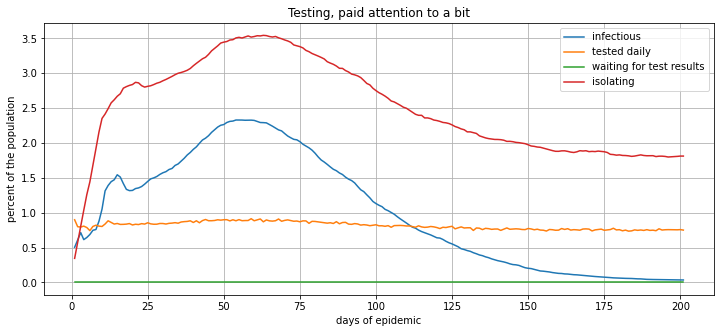

In [24]:
o_test.plot(title="Testing, paid attention to a bit")

In [25]:
HTML(o_test.outbreak_visualise(IS_HTML5))

2021-02-02 14:41:08,814 INFO:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


We add contact-tracing and isolation:

In [26]:
o_test_trace = Outbreak(society.TestingTracingSociety(), Covid(), **SCALE_SETTINGS).simulate()

2021-02-02 14:41:16,161 WARNING:Using a pre-existing population - does it have the right network structure?
2021-02-02 14:41:32,193 INFO:Day 1, prop infected is 0.01, prop infectious is 0.0051
2021-02-02 14:41:46,633 INFO:Day 8, prop infected is 0.02, prop infectious is 0.0072
2021-02-02 14:42:02,035 INFO:Day 15, prop infected is 0.03, prop infectious is 0.0111
2021-02-02 14:42:21,723 INFO:Day 22, prop infected is 0.03, prop infectious is 0.0072
2021-02-02 14:42:36,299 INFO:Day 29, prop infected is 0.04, prop infectious is 0.0065
2021-02-02 14:42:50,724 INFO:Day 36, prop infected is 0.05, prop infectious is 0.0062
2021-02-02 14:43:05,570 INFO:Day 43, prop infected is 0.05, prop infectious is 0.0056
2021-02-02 14:43:20,163 INFO:Day 50, prop infected is 0.06, prop infectious is 0.0049
2021-02-02 14:43:34,643 INFO:Day 57, prop infected is 0.06, prop infectious is 0.0044
2021-02-02 14:43:49,012 INFO:Day 64, prop infected is 0.06, prop infectious is 0.0039
2021-02-02 14:44:03,096 INFO:Day 7

2021-02-02 14:48:26,651 INFO: Realized R0 of early infections is 0.94
2021-02-02 14:48:26,652 INFO: 8.9 percent of the proportion was infected during the epidemic


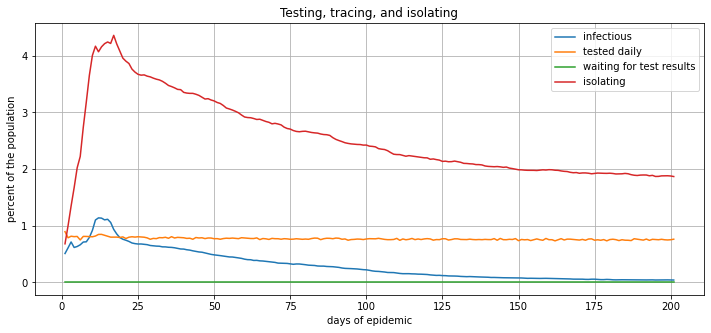

In [27]:
o_test_trace.plot(title='Testing, tracing, and isolating', secondary_y=['prop_infected'])

In [28]:
HTML(o_test_trace.outbreak_visualise(IS_HTML5))

2021-02-02 14:48:26,868 INFO:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


UK society, however, is characterized by testing bottlenecks:

In [29]:
import codit.society.alternatives
o_UK = Outbreak(society.alternatives.UKSociety(), Covid(), **SCALE_SETTINGS).simulate()

2021-02-02 14:48:33,807 WARNING:Using a pre-existing population - does it have the right network structure?
2021-02-02 14:48:50,201 INFO:Day 1, prop infected is 0.01, prop infectious is 0.0052
2021-02-02 14:49:05,209 INFO:Day 8, prop infected is 0.02, prop infectious is 0.0070
2021-02-02 14:49:20,645 INFO:Day 15, prop infected is 0.03, prop infectious is 0.0117
2021-02-02 14:49:39,557 INFO:Day 22, prop infected is 0.04, prop infectious is 0.0078
2021-02-02 14:49:54,492 INFO:Day 29, prop infected is 0.04, prop infectious is 0.0073
2021-02-02 14:50:09,390 INFO:Day 36, prop infected is 0.05, prop infectious is 0.0070
2021-02-02 14:50:24,538 INFO:Day 43, prop infected is 0.06, prop infectious is 0.0063
2021-02-02 14:50:39,440 INFO:Day 50, prop infected is 0.06, prop infectious is 0.0061
2021-02-02 14:50:54,466 INFO:Day 57, prop infected is 0.07, prop infectious is 0.0057
2021-02-02 14:51:09,415 INFO:Day 64, prop infected is 0.07, prop infectious is 0.0053
2021-02-02 14:51:24,890 INFO:Day 7

2021-02-02 14:56:01,553 INFO: Realized R0 of early infections is 0.97
2021-02-02 14:56:01,554 INFO: 11.1 percent of the proportion was infected during the epidemic


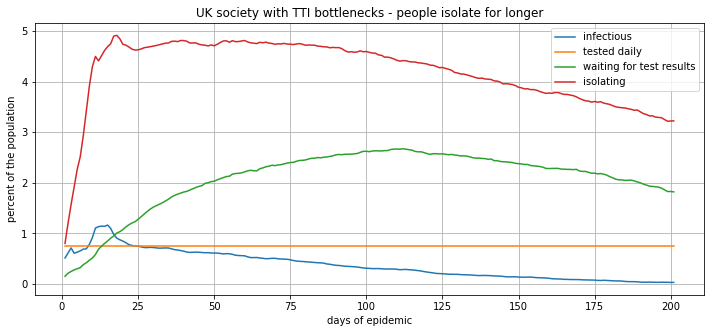

In [30]:
o_UK.plot(title='UK society with TTI bottlenecks - people isolate for longer')

In [31]:
HTML(o_UK.outbreak_visualise(IS_HTML5))

2021-02-02 14:56:01,764 INFO:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


In [32]:
o_contact_test = Outbreak(society.ContactTestingSociety(), Covid(), **SCALE_SETTINGS).simulate()

2021-02-02 14:56:08,649 WARNING:Using a pre-existing population - does it have the right network structure?
2021-02-02 14:56:26,053 INFO:Day 1, prop infected is 0.01, prop infectious is 0.0051
2021-02-02 14:56:42,562 INFO:Day 8, prop infected is 0.02, prop infectious is 0.0074
2021-02-02 14:57:03,539 INFO:Day 15, prop infected is 0.03, prop infectious is 0.0146
2021-02-02 14:57:21,787 INFO:Day 22, prop infected is 0.04, prop infectious is 0.0113
2021-02-02 14:57:40,324 INFO:Day 29, prop infected is 0.06, prop infectious is 0.0113
2021-02-02 14:58:00,674 INFO:Day 36, prop infected is 0.07, prop infectious is 0.0113
2021-02-02 14:58:21,055 INFO:Day 43, prop infected is 0.08, prop infectious is 0.0124
2021-02-02 14:58:41,197 INFO:Day 50, prop infected is 0.09, prop infectious is 0.0128
2021-02-02 14:59:01,175 INFO:Day 57, prop infected is 0.11, prop infectious is 0.0131
2021-02-02 14:59:21,488 INFO:Day 64, prop infected is 0.12, prop infectious is 0.0127
2021-02-02 14:59:41,588 INFO:Day 7

2021-02-02 15:05:24,161 INFO: Realized R0 of early infections is 1.08
2021-02-02 15:05:24,161 INFO: 20.2 percent of the proportion was infected during the epidemic


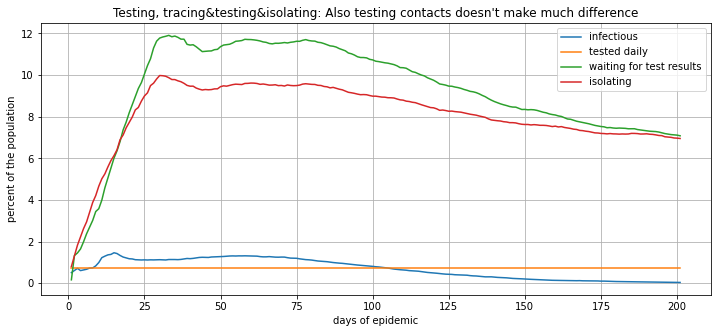

In [33]:
o_contact_test.plot(title="Testing, tracing&testing&isolating: "
                    "Also testing contacts doesn't make much difference", 
                    secondary_y=['prop_infected'])

In [34]:
HTML(o_contact_test.outbreak_visualise(IS_HTML5))

2021-02-02 15:05:24,380 INFO:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


In [35]:
infector_nets = [len(p.infector.contacts) for p in pop.people if p.infector]

In [36]:
infected_nets = [len(p.contacts) for p in pop.people if p.infected]

In [37]:
def most_connected_infector(guy):
    if guy.infector is None:
        raise NotImplementedError
    return max([len(i.contacts) for i in guy.chain() if i is not guy]) 

max_contacts_chain = [most_connected_infector(person)
                      for person in pop.people 
                      if person.infector is not None]

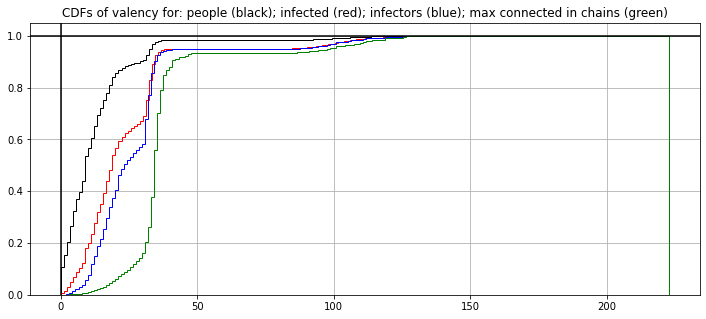

In [38]:
opts = dict(cumulative=True, bins=200, density=True, histtype='step')

plt.hist(nets, color='k', **opts)
plt.hist(infected_nets, color='r', **opts)
plt.hist(infector_nets, color='b', **opts)
plt.hist(max_contacts_chain, color='g', **opts)

plt.title("CDFs of valency for: people (black); infected (red); infectors (blue); max connected in chains (green)")
plt.axhline(1, color='k'); plt.axvline(0, color='k')
plt.grid()